In [1]:
TRAIN = '/kaggle/input/dataset-for-visual-plastic-type-recognition/Plastic types'

We need image embeddings for both EDA and logistic regression, so let's add some code that will get them from ResNeXt.

In [2]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth
100%|██████████| 95.8M/95.8M [00:00<00:00, 163MB/s]


Let's load up our data. We're going to try to balance the classes in our target variable, and we're going to get image embeddings and thumbnails. This seems like it is taking forever, but it only takes a little over thirteen minutes. 

In [3]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from PIL import Image

THUMBNAIL_SIZE = (64, 64)

def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'])
        for index, input_file in enumerate(list(iglob(pathname=arg))) if input_file.endswith('.jpg') and index < 600]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*')}
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
print('done in {}'.format(arrow.now() - time_start))

encoded 511 rows of PE  in 0:02:18.186692
encoded 527 rows of PS  in 0:02:11.981675
encoded 492 rows of PC  in 0:02:04.966283
encoded 594 rows of PET  in 0:02:30.294778
encoded 514 rows of PP  in 0:02:12.528680
encoded 526 rows of Others  in 0:02:12.502518
done in 0:13:30.666723


How close are we to having balanced the target class?

In [4]:
train_df['tag'].value_counts(normalize=True).to_frame().sort_values(by='proportion').T

tag,PC,PE,PP,Others,PS,PET
proportion,0.155499,0.161504,0.162453,0.166245,0.166561,0.187737


Next let's use TSNE to get x/y coordinates from our image embeddings.

In [5]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 3164 samples in 0.064s...
[t-SNE] Computed neighbors for 3164 samples in 0.889s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3164
[t-SNE] Computed conditional probabilities for sample 2000 / 3164
[t-SNE] Computed conditional probabilities for sample 3000 / 3164
[t-SNE] Computed conditional probabilities for sample 3164 / 3164
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.756821
[t-SNE] KL divergence after 1000 iterations: 1.182461


Now we're ready to plot.

In [6]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']])
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: plastics', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=8, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? At first glance we just see a mess, but upon further inspection we see that we have several meaningful clusters here. We have a lower center cluster that looks like just solid black or white, and unfortunately the cluster cuts across all of our classes. Ideally we would remove these images from our data. We have a couple of clusters of greyscale stripes that do likewise. And we have some images that are just vertical stripes. But the big cluster to the center left is much more interesting, and while it doesn't have a lot of tight clusters in it, we do see that within it, individual images tend to have neighbors that are mostly of the same class. So our data is messy, but not random. We should have low to moderate expectations regarding how accurate our model will be. Let's build a model and find out.

In [7]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(train_df['value'].apply(pd.Series), train_df['tag'], test_size=0.2, random_state=2024, stratify=train_df['tag'])
logreg = LogisticRegression(max_iter=10000, tol=1e-12).fit(X_train, y_train)
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=y_test, y_pred=logreg.predict(X=X_test))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=y_test, y_pred=logreg.predict(X=X_test))))
print(classification_report(y_true=y_test, y_pred=logreg.predict(X=X_test)))

model fit in 595 iterations
accuracy: 0.5419
f1: 0.5382
              precision    recall  f1-score   support

      Others       0.48      0.49      0.48       105
          PC       0.41      0.35      0.38        98
          PE       0.63      0.56      0.59       102
         PET       0.61      0.75      0.67       119
          PP       0.48      0.51      0.50       103
          PS       0.61      0.56      0.58       106

    accuracy                           0.54       633
   macro avg       0.54      0.54      0.53       633
weighted avg       0.54      0.54      0.54       633



At first glance this looks disappointing, but it is important to keep in mind that a dummy model would have an accuracy of about 0.16. Let's look at our confusion matrix.

<Axes: >

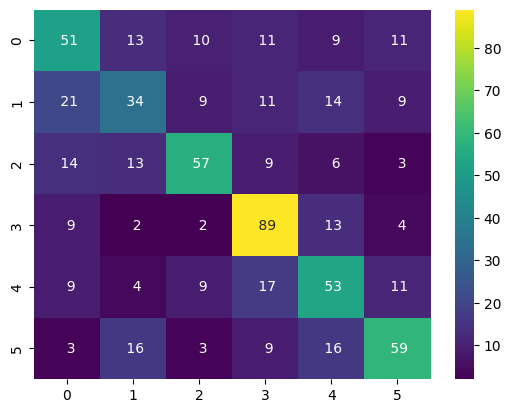

In [8]:
from seaborn import heatmap
from sklearn.metrics import confusion_matrix

heatmap(annot=True, data=pd.DataFrame(data=confusion_matrix(y_true=y_test, y_pred=logreg.predict(X=X_test), ),), cmap='viridis', fmt='3')

Honestly it looks like our misclassifications are mostly randomly distributed. What do our model probabilities look like?

<Axes: xlabel='x', ylabel='y'>

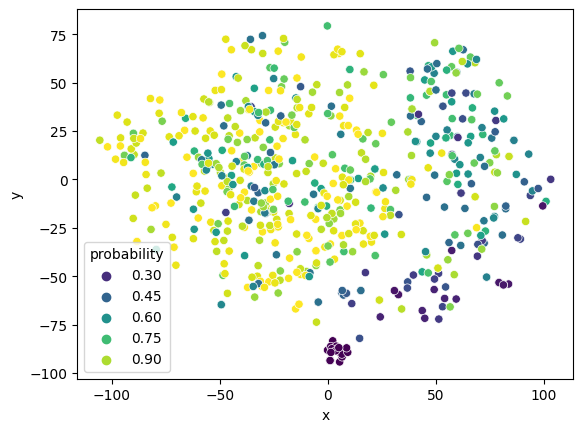

In [9]:
from seaborn import scatterplot

plot_df = train_df.iloc[X_test.index][['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=X_test), axis=1)
scatterplot(data=plot_df, x='x', y='y', hue='probability', palette='viridis')

As we might have expected from our visual inspection of the data above, our low model probabilities are concentrated in our more difficult images, for the most part, but with some difficult cases sprinkled all through our higher-quality data as well. This is a tough problem.